In [1]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import random
import os
#For working with images:
import PIL
import cv2
import matplotlib.image as mpimg
from PIL import Image
import shutil

In [2]:
!pwd

/Users/catarinavuzi/Downloads


# **Exploratory Data Analysis**

- This notebook is for the EDA.

- This first step is to navigate through the folder to see the structure.

- The Dataset was already split into test, train, and validation.

- There are 10 classes. 9 different  types of leaf diseases and one class with the healthy images.

- The classes have different number of images. The tomato yellow leaf curl virus class is the class with the most images.

- The insight that I get from the bar graph is that I am working with an imbalance dataset.

- The dataset also contains some low quality images with lighting  issues and some images have a different background (a black ground). This may cause problems for the deep learning part
 


In [3]:
# Define the base path
base_path = '/Users/catarinavuzi/Downloads/image data'

# Define the subdirectories
subdirs = ['test', 'train', 'validation']

# Iterate through each subdirectory
for subdir in subdirs:
    tomato_path = os.path.join(base_path, subdir, 'tomato')
    if os.path.exists(tomato_path):
        print(f"Contents of {tomato_path}:")
        for item in os.listdir(tomato_path):
            print(f"  - {item}")
    else:
        print(f"{tomato_path} does not exist.")

Contents of /Users/catarinavuzi/Downloads/image data/test/tomato:
  - bacterial spot
  - spider mites two-spotted spider mite
  - early blight
  - healthy
  - late blight
  - tomato mosaic virus
  - tomato yellow leaf curl virus
  - target spot
  - septoria leaf spot
  - leaf mold
Contents of /Users/catarinavuzi/Downloads/image data/train/tomato:
  - bacterial spot
  - spider mites two-spotted spider mite
  - early blight
  - healthy
  - late blight
  - tomato mosaic virus
  - tomato yellow leaf curl virus
  - target spot
  - septoria leaf spot
  - leaf mold
Contents of /Users/catarinavuzi/Downloads/image data/validation/tomato:
  - bacterial spot
  - spider mites two-spotted spider mite
  - early blight
  - healthy
  - late blight
  - tomato mosaic virus
  - tomato yellow leaf curl virus
  - target spot
  - septoria leaf spot
  - leaf mold


In [4]:
# Iterate through each subdirectory
for subdir in subdirs:
    tomato_path = os.path.join(base_path, subdir, 'tomato')
    if os.path.exists(tomato_path):
        print(f"Contents of {tomato_path}:")
        classes = [item for item in os.listdir(tomato_path) if os.path.isdir(os.path.join(tomato_path, item))]
        print(f"Number of classes in {subdir}: {len(classes)}")
        for item in classes:
            print(f"  - {item}")
    else:
        print(f"{tomato_path} does not exist.")

Contents of /Users/catarinavuzi/Downloads/image data/test/tomato:
Number of classes in test: 10
  - bacterial spot
  - spider mites two-spotted spider mite
  - early blight
  - healthy
  - late blight
  - tomato mosaic virus
  - tomato yellow leaf curl virus
  - target spot
  - septoria leaf spot
  - leaf mold
Contents of /Users/catarinavuzi/Downloads/image data/train/tomato:
Number of classes in train: 10
  - bacterial spot
  - spider mites two-spotted spider mite
  - early blight
  - healthy
  - late blight
  - tomato mosaic virus
  - tomato yellow leaf curl virus
  - target spot
  - septoria leaf spot
  - leaf mold
Contents of /Users/catarinavuzi/Downloads/image data/validation/tomato:
Number of classes in validation: 10
  - bacterial spot
  - spider mites two-spotted spider mite
  - early blight
  - healthy
  - late blight
  - tomato mosaic virus
  - tomato yellow leaf curl virus
  - target spot
  - septoria leaf spot
  - leaf mold


In [5]:
# Iterate through each subdirectory
for subdir in subdirs:
    tomato_path = os.path.join(base_path, subdir, 'tomato')
    if os.path.exists(tomato_path):
        print(f"Contents of {tomato_path}:")
        classes = [item for item in os.listdir(tomato_path) if os.path.isdir(os.path.join(tomato_path, item))]
        for class_name in classes:
            class_path = os.path.join(tomato_path, class_name)
            num_images = len([img for img in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, img))])
            print(f"  - {class_name}: {num_images} images")
    else:
        print(f"{tomato_path} does not exist.")

Contents of /Users/catarinavuzi/Downloads/image data/test/tomato:
  - bacterial spot: 212 images
  - spider mites two-spotted spider mite: 167 images
  - early blight: 100 images
  - healthy: 159 images
  - late blight: 190 images
  - tomato mosaic virus: 37 images
  - tomato yellow leaf curl virus: 535 images
  - target spot: 140 images
  - septoria leaf spot: 177 images
  - leaf mold: 95 images
Contents of /Users/catarinavuzi/Downloads/image data/train/tomato:
  - bacterial spot: 1532 images
  - spider mites two-spotted spider mite: 1208 images
  - early blight: 720 images
  - healthy: 1146 images
  - late blight: 1376 images
  - tomato mosaic virus: 269 images
  - tomato yellow leaf curl virus: 3858 images
  - target spot: 1012 images
  - septoria leaf spot: 1276 images
  - leaf mold: 686 images
Contents of /Users/catarinavuzi/Downloads/image data/validation/tomato:
  - bacterial spot: 383 images
  - spider mites two-spotted spider mite: 301 images
  - early blight: 180 images
  - h

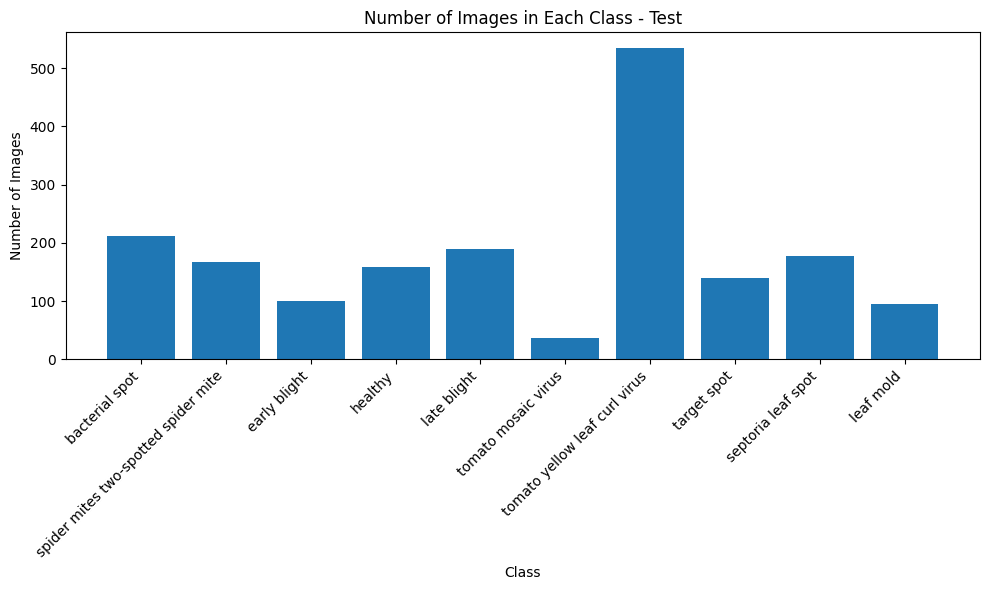

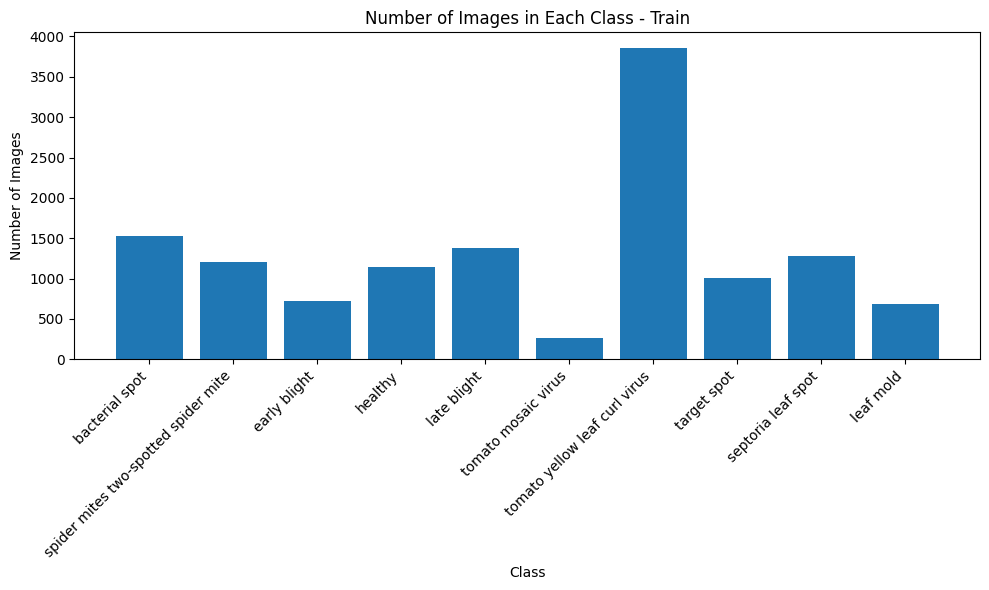

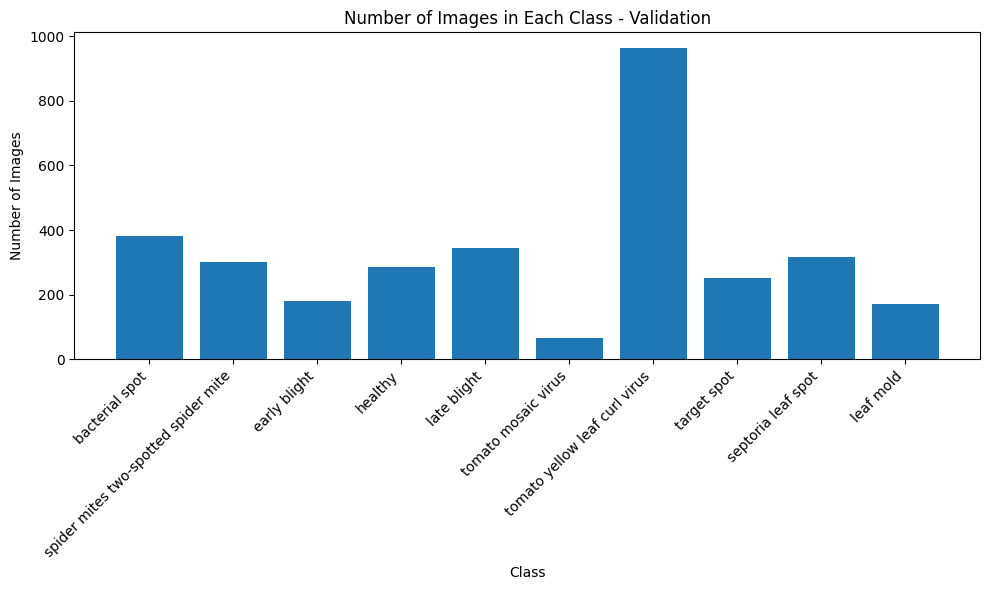

In [6]:
# Dictionary to store the number of images in each class for each subdirectory
data = {subdir: {} for subdir in subdirs}

# Iterate through each subdirectory
for subdir in subdirs:
    tomato_path = os.path.join(base_path, subdir, 'tomato')
    if os.path.exists(tomato_path):
        classes = [item for item in os.listdir(tomato_path) if os.path.isdir(os.path.join(tomato_path, item))]
        for class_name in classes:
            class_path = os.path.join(tomato_path, class_name)
            num_images = len([img for img in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, img))])
            data[subdir][class_name] = num_images

# Plotting the data
for subdir, class_data in data.items():
    plt.figure(figsize=(10, 6))
    plt.bar(class_data.keys(), class_data.values())
    plt.xlabel('Class')
    plt.ylabel('Number of Images')
    plt.title(f'Number of Images in Each Class - {subdir.capitalize()}')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

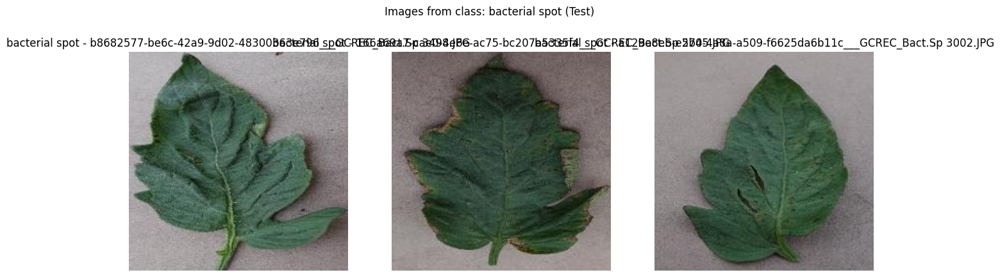

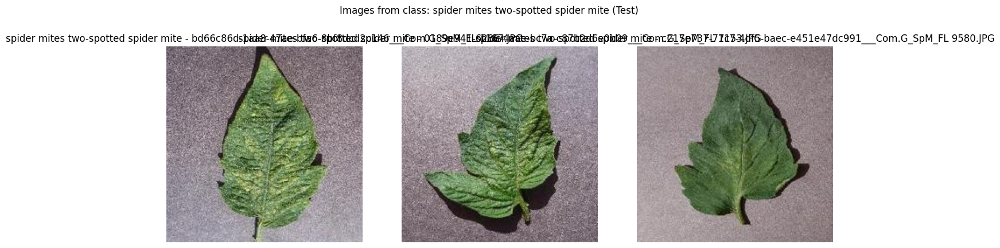

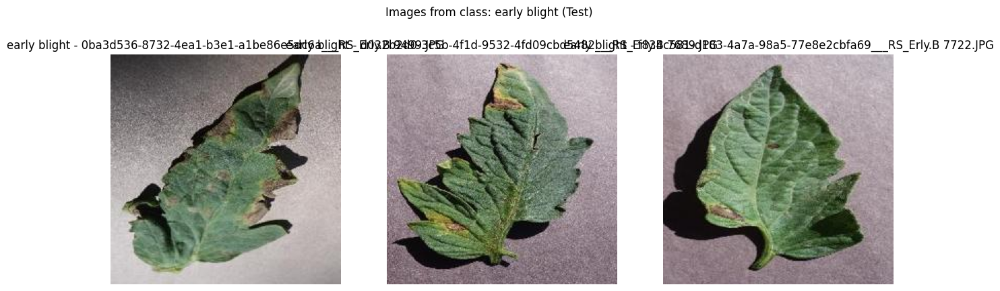

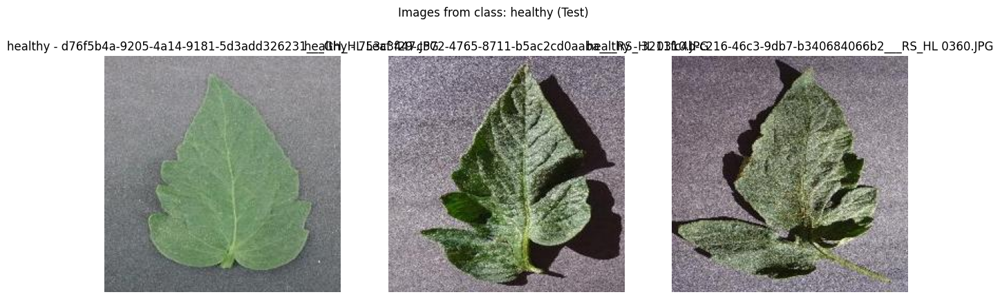

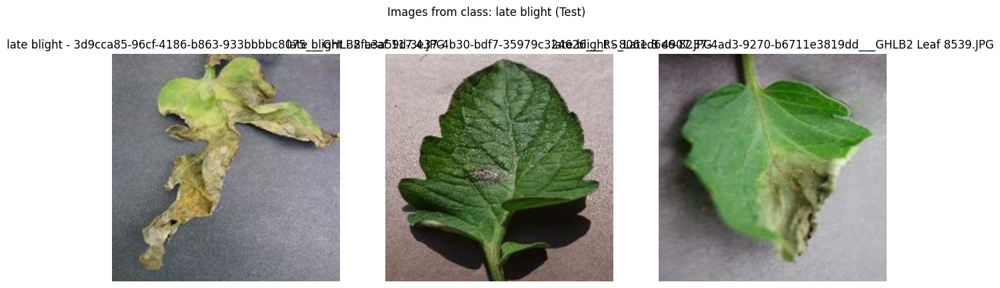

...

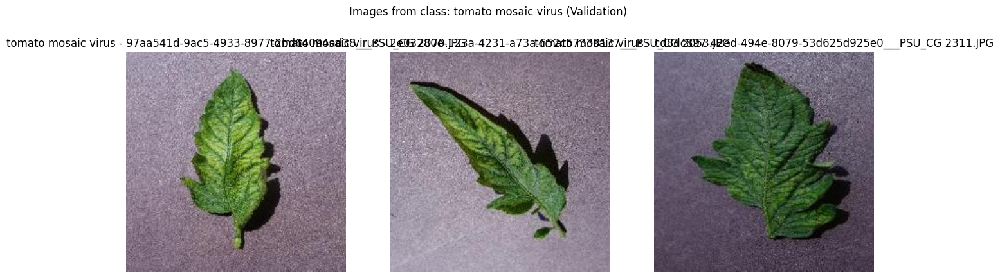

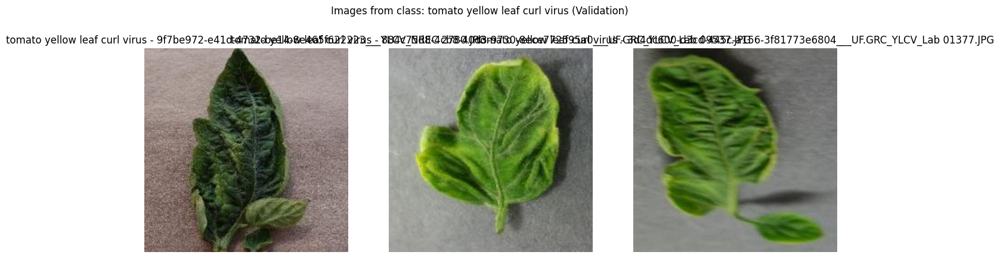

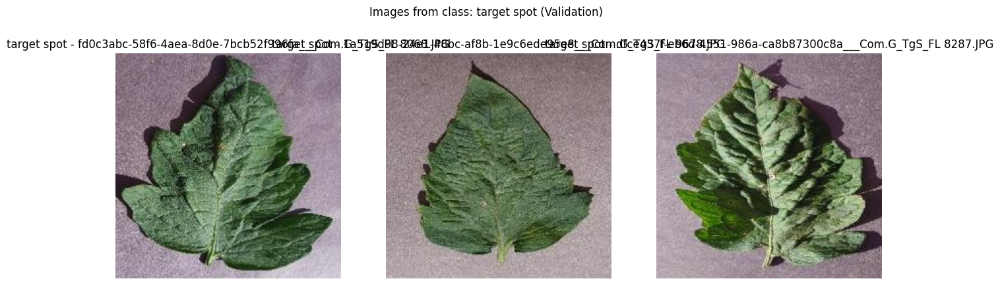

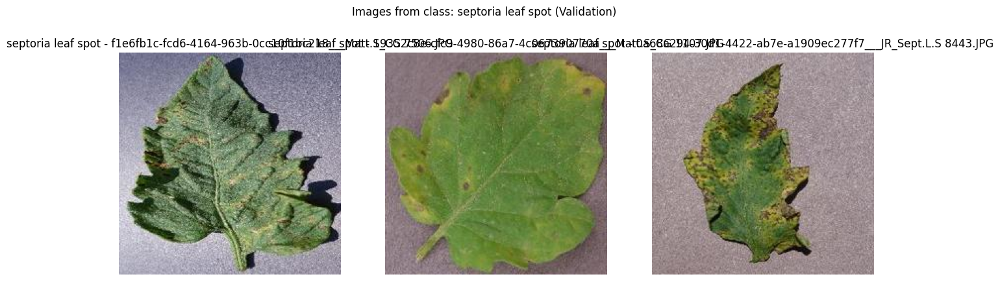

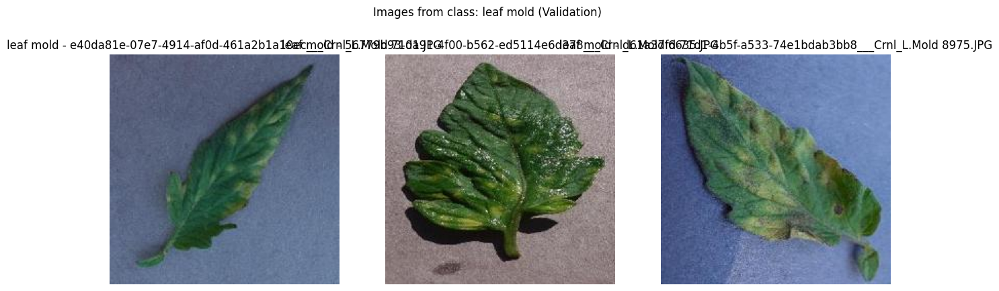

In [7]:
# Number of images to display per class
num_images_to_display = 3

# Iterate through each subdirectory
for subdir in subdirs:
    tomato_path = os.path.join(base_path, subdir, 'tomato')
    if os.path.exists(tomato_path):
        classes = [item for item in os.listdir(tomato_path) if os.path.isdir(os.path.join(tomato_path, item))]
        for class_name in classes:
            class_path = os.path.join(tomato_path, class_name)
            images = [img for img in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, img))]
            plt.figure(figsize=(15, 5))
            for i, img_name in enumerate(images[:num_images_to_display]):
                img_path = os.path.join(class_path, img_name)
                img = Image.open(img_path)
                plt.subplot(1, num_images_to_display, i + 1)
                plt.imshow(img)
                plt.title(f'{class_name} - {img_name}')
                plt.axis('off')
            plt.suptitle(f'Images from class: {class_name} ({subdir.capitalize()})')
            plt.show()
    else:
        print(f"{tomato_path} does not exist.")

In [8]:
# Function to check if an image is blurry
def is_blurry(image_path, threshold=100):
  image = cv2.imread(image_path)
  gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  fm = cv2.Laplacian(gray, cv2.CV_64F).var()
  if fm < threshold:
    return True
  else:
    return False


# Iterate through each subdirectory
for subdir in subdirs:
    tomato_path = os.path.join(base_path, subdir, 'tomato')
    if os.path.exists(tomato_path):
        print(f"Contents of {tomato_path}:")
        classes = [item for item in os.listdir(tomato_path) if os.path.isdir(os.path.join(tomato_path, item))]
        for class_name in classes:
            class_path = os.path.join(tomato_path, class_name)
            images = [img for img in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, img))]
            blurry_images = []
            for img_name in images:
                img_path = os.path.join(class_path, img_name)
                if is_blurry(img_path):
                    blurry_images.append(img_name)
            print(f"  - {class_name}: {len(blurry_images)} blurry images")
    else:
        print(f"{tomato_path} does not exist.")

Contents of /Users/catarinavuzi/Downloads/image data/test/tomato:
  - bacterial spot: 1 blurry images
  - spider mites two-spotted spider mite: 0 blurry images
  - early blight: 0 blurry images
  - healthy: 0 blurry images
  - late blight: 3 blurry images
  - tomato mosaic virus: 0 blurry images
  - tomato yellow leaf curl virus: 132 blurry images
  - target spot: 0 blurry images
  - septoria leaf spot: 0 blurry images
  - leaf mold: 0 blurry images
Contents of /Users/catarinavuzi/Downloads/image data/train/tomato:
  - bacterial spot: 6 blurry images
  - spider mites two-spotted spider mite: 0 blurry images
  - early blight: 2 blurry images
  - healthy: 0 blurry images
  - late blight: 36 blurry images
  - tomato mosaic virus: 0 blurry images
  - tomato yellow leaf curl virus: 1036 blurry images
  - target spot: 0 blurry images
  - septoria leaf spot: 0 blurry images
  - leaf mold: 2 blurry images
Contents of /Users/catarinavuzi/Downloads/image data/validation/tomato:
  - bacterial spo

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

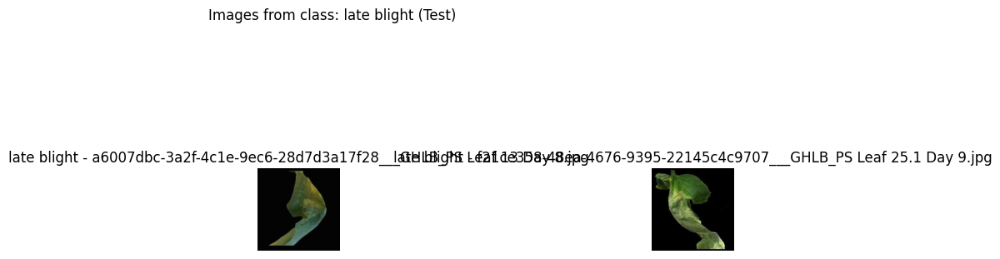

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

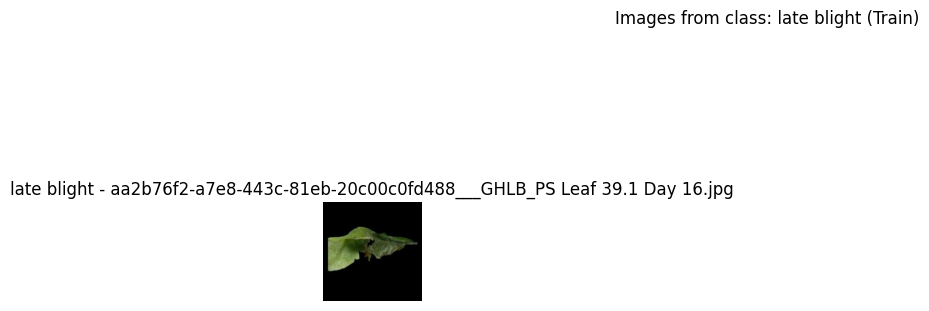

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

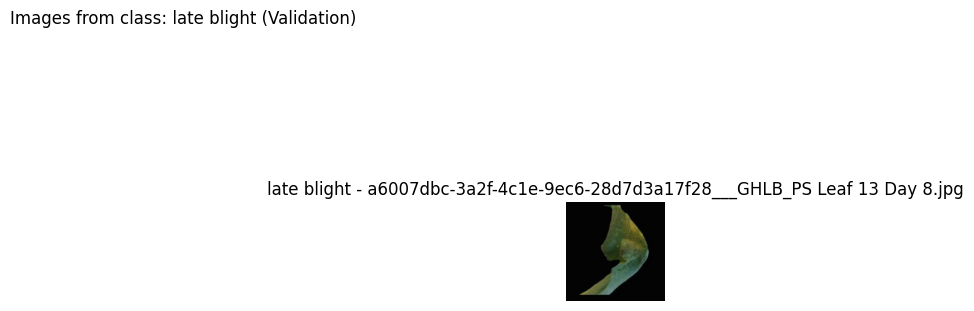

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

<Figure size 1500x500 with 0 Axes>

In [9]:
# Number of images to display per class
num_images_to_display = 10

# Iterate through each subdirectory
for subdir in subdirs:
    tomato_path = os.path.join(base_path, subdir, 'tomato')
    if os.path.exists(tomato_path):
        classes = [item for item in os.listdir(tomato_path) if os.path.isdir(os.path.join(tomato_path, item))]
        for class_name in classes:
            class_path = os.path.join(tomato_path, class_name)
            images = [img for img in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, img))]
            plt.figure(figsize=(15, 5))
            for i, img_name in enumerate(images[:num_images_to_display]):
                img_path = os.path.join(class_path, img_name)
                img = cv2.imread(img_path)  # Read image using OpenCV
                if img is not None:
                    # Check if the background is mostly black
                    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
                    if np.mean(gray) < 50:  # Adjust threshold as needed
                        plt.subplot(1, num_images_to_display, i + 1)
                        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for matplotlib
                        plt.title(f'{class_name} - {img_name}')
                        plt.axis('off')
            plt.suptitle(f'Images from class: {class_name} ({subdir.capitalize()})')
            plt.show()
    else:
        print(f"{tomato_path} does not exist.")

In [10]:
# Function to check for imbalance
def check_imbalance(class_data):
    total_images = sum(class_data.values())
    avg_images = total_images / len(class_data)
    threshold = avg_images * 0.5  # 50% of the average number of images
    for class_name, num_images in class_data.items():
        if num_images < threshold:
            return "Yes"
    return "No"

# Dictionary to store the number of images in each class for each subdirectory
data = {subdir: {} for subdir in subdirs}

# Iterate through each subdirectory
for subdir in subdirs:
    tomato_path = os.path.join(base_path, subdir, 'tomato')
    if os.path.exists(tomato_path):
        classes = [item for item in os.listdir(tomato_path) if os.path.isdir(os.path.join(tomato_path, item))]
        for class_name in classes:
            class_path = os.path.join(tomato_path, class_name)
            num_images = len([img for img in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, img))])
            data[subdir][class_name] = num_images

# Check for imbalance in each subdirectory
for subdir, class_data in data.items():
    imbalance = check_imbalance(class_data)
    print(f"Is there an imbalance in {subdir.capitalize()}? {imbalance}")

Is there an imbalance in Test? Yes
Is there an imbalance in Train? Yes
Is there an imbalance in Validation? Yes
